# LSI31003 Machine Learning in Molecular Biology Assignment 1

# Heidi Putkuri - 014976544
I have used both GPT-4 and github copilot to help me with this assignment in the coding sections. I have also used some sources which are marked in the text.

In [336]:
from setup import *
import seaborn as sns
%matplotlib inline
import plotly.io as pio
pio.renderers.default = 'notebook'
import plotly.express as px

##  Introduction <a id='section1'></a>

Here we will explore a somatic mutation data set from ["Alexandrov LB, et al. (2020) The repertoire of mutational signatures in human cancer. Nature"](https://www.nature.com/articles/s41586-020-1943-3). 

In [77]:
## ploting 96 mutational channels
col_set = ['#0343df','#000000','#e50000','#929591','#3f9b0b','#ff81c0']
col_list = []
for i in range (len(col_set)):
    col_list += [col_set[i]] * 16

def plot_mutationchannels(sig, name=""):
    # the sig given to the function is a pandas series
    # the index of the series is the 96 channels
    sns.set(rc={"figure.figsize":(11,2.5)})
    sns.set(style="whitegrid", color_codes=True)

    plt.bar(sig.index, sig, width = 0.5, color = col_list)
    plt.xticks(rotation=90, size = 7, weight='bold')
    plt.title (name, size = 12, weight='bold')
    plt.tight_layout()
    plt.show()

### Load mutational catalogs from cancer whole genome sequenced data

Here we will use single base substitution (SBS) data of 2780 cancer genomes from PCAWG project in this assignment. First, let's load the data matrix from the local data folder.

In [78]:
somaticMutations = pd.read_csv ("./data/MutSigCancer/WGS_PCAWG.96.csv")
somaticMutations = somaticMutations.set_index (somaticMutations['Mutation type'] + "_" + somaticMutations['Trinucleotide'])

In [79]:
somaticMutations.head(2)

,Mutation type,Trinucleotide,Biliary-AdenoCA::SP117655,Biliary-AdenoCA::SP117556,Biliary-AdenoCA::SP117627,Biliary-AdenoCA::SP117775,Biliary-AdenoCA::SP117332,Biliary-AdenoCA::SP117712,Biliary-AdenoCA::SP117017,Biliary-AdenoCA::SP117031,...,Uterus-AdenoCA::SP94540,Uterus-AdenoCA::SP95222,Uterus-AdenoCA::SP89389,Uterus-AdenoCA::SP90503,Uterus-AdenoCA::SP92460,Uterus-AdenoCA::SP92931,Uterus-AdenoCA::SP91265,Uterus-AdenoCA::SP89909,Uterus-AdenoCA::SP90629,Uterus-AdenoCA::SP95550
C>A_ACA,C>A,ACA,269,114,105,217,52,192,54,196,...,117,233,94,114,257,139,404,97,250,170
C>A_ACC,C>A,ACC,148,56,71,123,36,139,54,102,...,90,167,59,64,268,75,255,78,188,137


Okay so it seems that the rows are the 96 mutation types and the columns are the 2780 samples. 

Next we will use the above given function to visualize the data from an individual case:

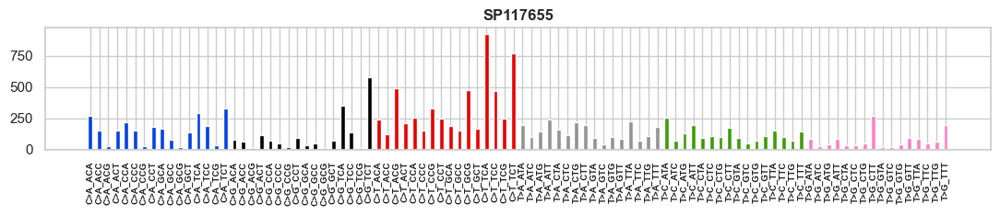

In [80]:
SP117655_profile = somaticMutations['Biliary-AdenoCA::SP117655']
plot_mutationchannels(SP117655_profile,"SP117655")

### Load mutational signatures from Alexandrov *et al.'s* paper

There are 65 SBS signatures have been reported based on the paper.

In [81]:
SBS_sig = pd.read_csv("./data/MutSigCancer/SBS_signatures.csv")
SBS_sig = SBS_sig.set_index (SBS_sig['Type'] + "_" + SBS_sig['SubType'])
SBS_sig.head(2)

,Type,SubType,SBS1,SBS2,SBS3,SBS4,SBS5,SBS6,SBS7a,SBS7b,...,SBS51,SBS52,SBS53,SBS54,SBS55,SBS56,SBS57,SBS58,SBS59,SBS60
C>A_ACA,C>A,ACA,0.000886,5.800000e-07,0.0208,0.0422,0.01200,0.000425,0.000067,0.002330,...,0.14100,0.01520,0.00538,0.002160,0.00588,0.0126,0.01230,0.05890,0.00359,0.006150
C>A_ACC,C>A,ACC,0.002280,1.480000e-04,0.0165,0.0333,0.00944,0.000524,0.000179,0.000461,...,0.00169,0.00654,0.00196,0.000796,0.00205,0.0157,0.00143,0.00675,0.00237,0.000779


Here is an example of showing the spectrum of the fourth signature, which is found associated with tobacco consuming in lung cancers.

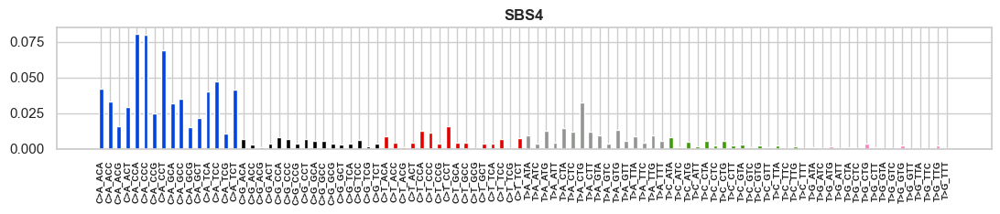

In [82]:
name = 'SBS4'
sig = SBS_sig[name]
plot_mutationchannels(sig, name)

In [83]:
channels6 = list(set(list(SBS_sig['Type'].values)))
channels6

['T>C', 'T>G', 'C>A', 'T>A', 'C>G', 'C>T']

### Problem 1: Explore the data in various ways by visualisation as well as by summary statistics <a id='Problem1'></a>

## Problem 1a: Using the data matrix somaticMutations make a summary plot of total number of mutations per sample per cancer type, see for reference Figure 1 (the top panel) in Alexandrov et al.'s paper. 

## COMMENT : do you mean the Figure 1 inside the paper ? : this one  ? What is meant by the top panel ? 

![title](./fig1.png)


## 1A ANSWER

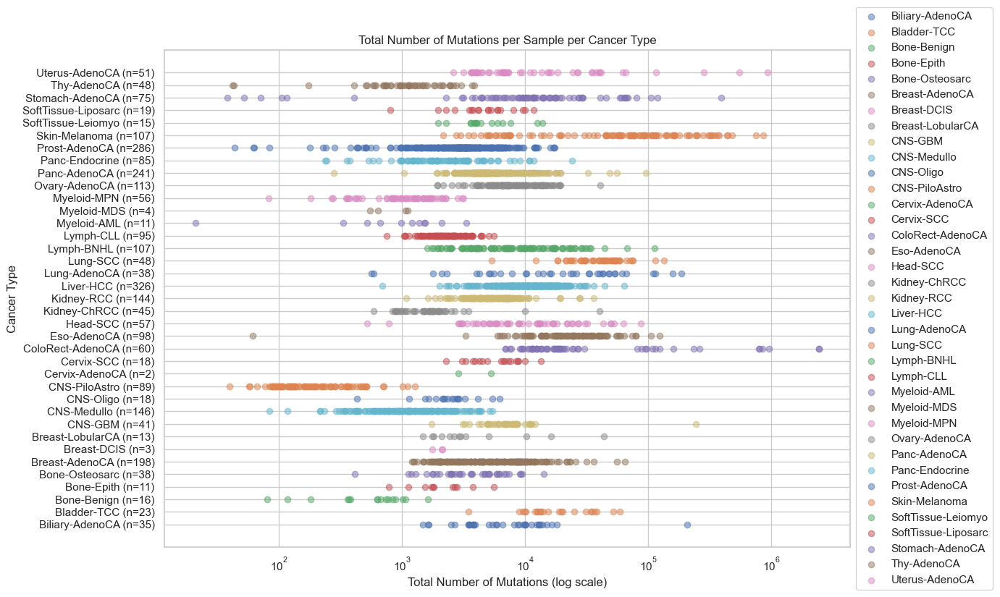

In [55]:

# remove the first two columns
somaticMutations = somaticMutations[somaticMutations.columns[2:]]

# now the index is the 96 channels --> the type of mutation and the trinucleotide context
# the columns names has two parts --> the first part is the sample cancer type and the second part is the sample ID
# example of the column name: Biliary-AdenoCA::SP117655
# the value in each cell is the number of mutations in that channel
cancer_types = [col.split('::')[0] for col in somaticMutations.columns]

# Get unique cancer types and sort them to  
unique_cancer_types = sorted(set(cancer_types))

total_mutations_per_sample = somaticMutations.sum(axis=0)

mutations_per_cancer_type = {cancer: [] for cancer in unique_cancer_types}

for sample, total in zip(somaticMutations.columns, total_mutations_per_sample):
    cancer_type = sample.split('::')[0]
    mutations_per_cancer_type[cancer_type].append(total) 

y_labels = [f"{cancer_type} (n={len(mutations_per_cancer_type[cancer_type])})" for cancer_type in unique_cancer_types]

plt.figure(figsize=(12, 8))

# then in for loop, we plot the total number of mutations for each sample in each cancer type
for i, cancer_type in enumerate(unique_cancer_types):
    x = mutations_per_cancer_type[cancer_type] 
    y = [i] * len(x)   # this is to make the scatter plot for each cancer type in a separate horizontal line
    plt.scatter(x, y, alpha=0.5)

plt.yticks(range(len(unique_cancer_types)), y_labels)

plt.xscale('log')  
plt.xlabel('Total Number of Mutations (log scale)')
plt.ylabel('Cancer Type')
plt.title('Total Number of Mutations per Sample per Cancer Type')
plt.grid(True)
plt.tight_layout()
plt.legend(unique_cancer_types, loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


#### Problem 1b: 
Visualise the mutational signatures. The data is in variable SBS_sig.

We have given one example in the beginning. More references could be found in mutational signature database ["COSMIC: Signatures of Mutational Processes in Human Cancer"](https://cancer.sanger.ac.uk/cosmic/signatures/SBS/). You could also write your own code and visualize all signatures using it.

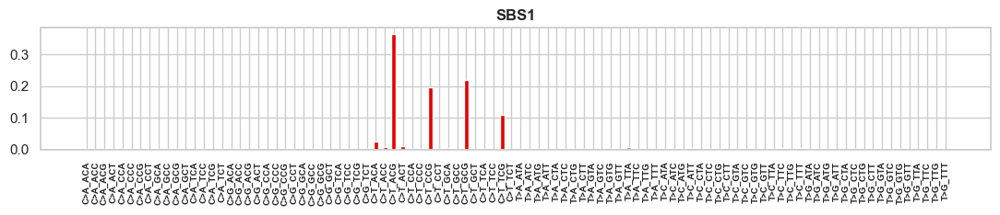

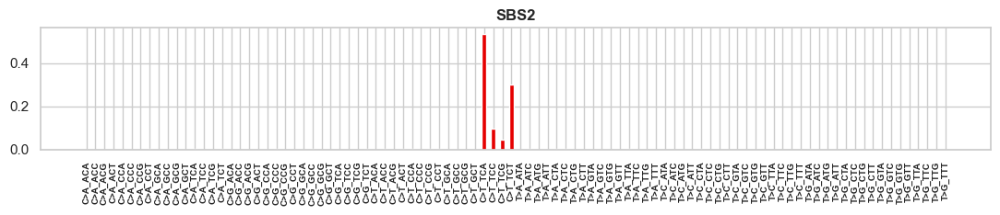

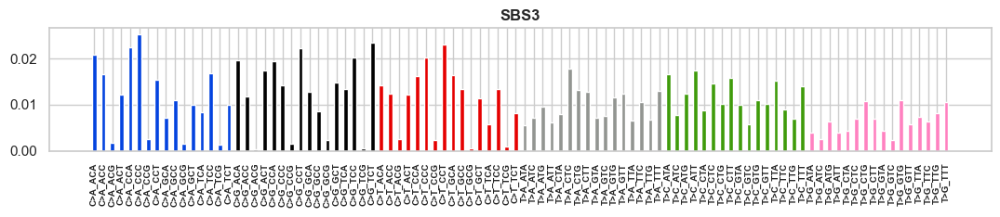

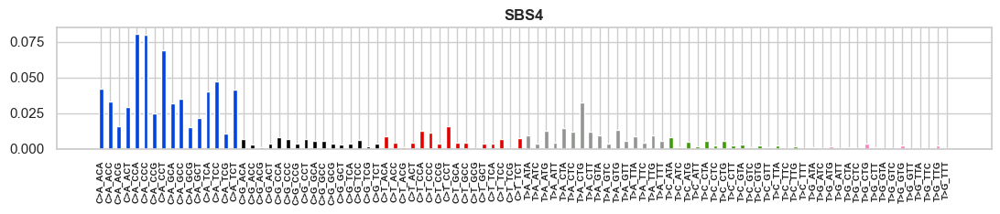

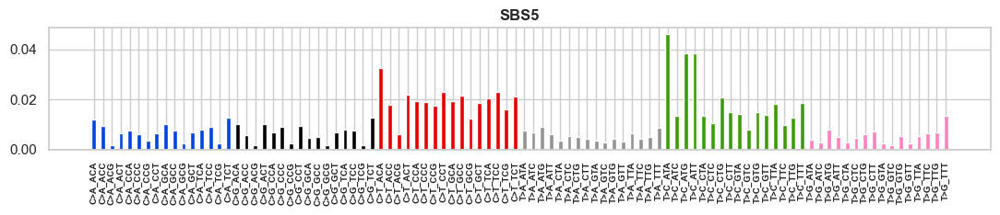

...

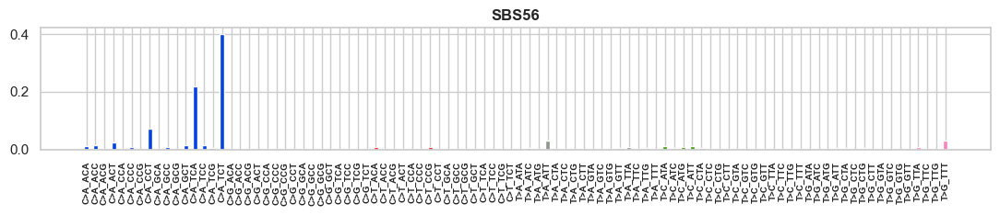

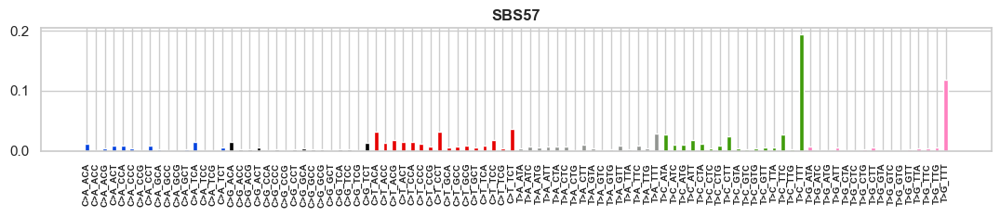

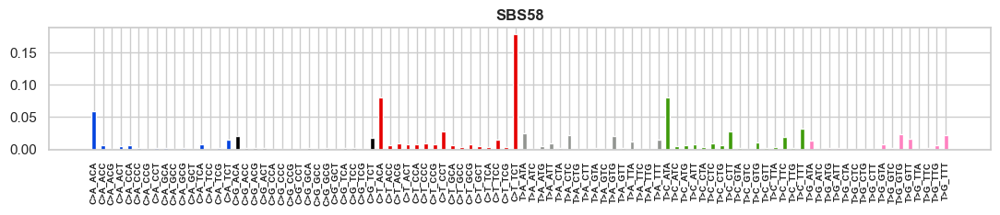

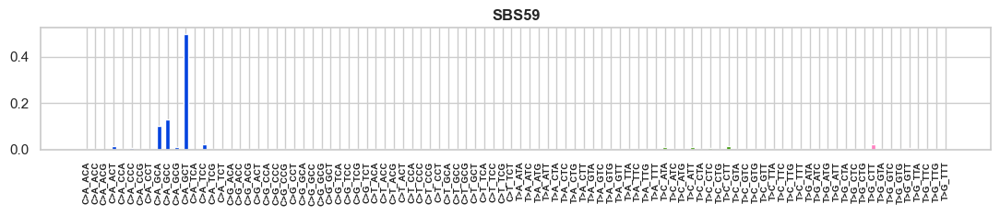

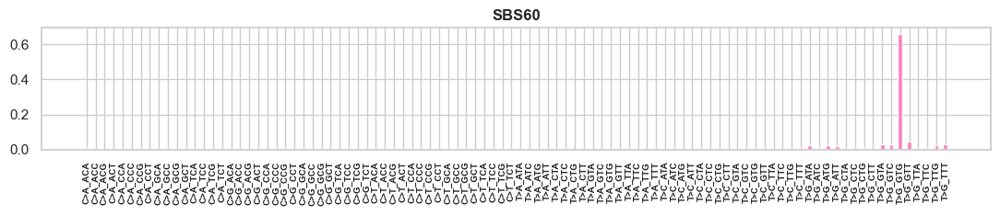

In [56]:
SBS_sig = SBS_sig.drop(columns=['Type', 'SubType'])

# using the function plot_mutationchannels
for i in range (len(SBS_sig.columns)):
    plot_mutationchannels(SBS_sig[SBS_sig.columns[i]], SBS_sig.columns[i])


#### Problem 1c: 
First, normalise mutation counts in the 96 channels for each individual sample so that they sum up to 1 to get sample specific mutations densities.  Then form the average of these densities for each cancer type and visualise the averages. 

Make this both at the 96 mutation channel level as well as summing over the context so that only 6 mutational channels remain, (as they are listed in channels6).

Can you see differences between cancer types? Use Figure 3 (and Figure 1 for the 6 channel version) from Alexandrov *et al.* to help look for cancer types that could look different when inspected via such average profiles. 

I am assuming here the SBS's are the mutation SIGNATURES and the mutational CHANNELS are the mutation MUTATION TYPES. (C>A, C>G, C>T, T>A, T>C, T>G etc.)

In [200]:
#copy the original dataframe
normalized_df= somaticMutations.copy()
# get the cancer types from the columns
cancer_types = [col.split('::')[0] for col in normalized_df.columns]

# normalize the data by the total number of mutations in each sample each column sums to 1 
normalized_df = normalized_df.div(normalized_df.drop(columns=['Mutation type', 'Trinucleotide']).sum(axis=0), axis=1)


In [490]:
normalized_df

,Biliary-AdenoCA::SP117017,Biliary-AdenoCA::SP117031,Biliary-AdenoCA::SP117332,Biliary-AdenoCA::SP117425,Biliary-AdenoCA::SP117556,Biliary-AdenoCA::SP117621,Biliary-AdenoCA::SP117627,Biliary-AdenoCA::SP117655,Biliary-AdenoCA::SP117712,Biliary-AdenoCA::SP117759,...,Uterus-AdenoCA::SP94661,Uterus-AdenoCA::SP94741,Uterus-AdenoCA::SP94917,Uterus-AdenoCA::SP94933,Uterus-AdenoCA::SP95126,Uterus-AdenoCA::SP95222,Uterus-AdenoCA::SP95406,Uterus-AdenoCA::SP95454,Uterus-AdenoCA::SP95550,Uterus-AdenoCA::SP95646
C>A_ACA,0.008229,0.019663,0.015046,0.010428,0.022406,0.013283,0.017728,0.018054,0.016981,0.018182,...,0.020876,0.003888,0.005193,0.008456,0.010574,0.015431,0.015677,0.003159,0.018745,0.021994
C>A_ACC,0.008229,0.010233,0.010417,0.008111,0.011006,0.010098,0.011987,0.009933,0.012293,0.014050,...,0.009635,0.003451,0.004686,0.005221,0.007683,0.011060,0.017327,0.003774,0.015106,0.015572
C>A_ACG,0.001829,0.001505,0.002315,0.001086,0.002555,0.001554,0.002195,0.001678,0.002742,0.001052,...,0.001606,0.000316,0.000811,0.000945,0.001407,0.001921,0.004400,0.000492,0.003529,0.005458
C>A_ACT,0.006248,0.012239,0.008970,0.007676,0.013758,0.009554,0.012325,0.010336,0.010524,0.012847,...,0.012847,0.004326,0.006789,0.004853,0.008710,0.014107,0.011276,0.004800,0.012791,0.016536
C>A_CCA,0.008229,0.013343,0.008681,0.009124,0.012382,0.010486,0.011987,0.014430,0.016804,0.023742,...,0.019729,0.012662,0.011880,0.004885,0.007873,0.012451,0.012101,0.013621,0.014004,0.013004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T>G_GTT,0.002591,0.004615,0.002025,0.004924,0.002948,0.005049,0.002364,0.005973,0.006191,0.004433,...,0.002524,0.002406,0.002634,0.007671,0.005059,0.005033,0.003300,0.002379,0.003529,0.005458
T>G_TTA,0.002895,0.004715,0.004340,0.004707,0.005110,0.003418,0.002701,0.005570,0.004334,0.001728,...,0.004818,0.000535,0.001596,0.002546,0.004792,0.005033,0.004400,0.000821,0.003198,0.004977
T>G_TTC,0.002286,0.002809,0.002315,0.001955,0.001965,0.002330,0.001351,0.003221,0.003449,0.001578,...,0.003900,0.000875,0.001317,0.003251,0.002662,0.003311,0.002750,0.000944,0.003639,0.004656
T>G_TTG,0.001676,0.004514,0.004630,0.003186,0.006093,0.004039,0.002533,0.004228,0.004953,0.003005,...,0.005047,0.002066,0.001469,0.005445,0.004868,0.004570,0.003300,0.002010,0.004631,0.006422


In [201]:
# calculate the mean of the normalized data for each cancer type so group each column by the cancer type and calculate the mean
avg_densities_96 = normalized_df.groupby(cancer_types, axis=1).mean()

In [202]:
avg_densities_96

,Biliary-AdenoCA,Bladder-TCC,Bone-Benign,Bone-Epith,Bone-Osteosarc,Breast-AdenoCA,Breast-DCIS,Breast-LobularCA,CNS-GBM,CNS-Medullo,...,Panc-AdenoCA,Panc-Endocrine,Prost-AdenoCA,Skin-Melanoma,SoftTissue-Leiomyo,SoftTissue-Liposarc,Stomach-AdenoCA,Thy-AdenoCA,Trinucleotide,Uterus-AdenoCA
C>A_ACA,0.017865,0.011366,0.027813,0.020250,0.019561,0.017367,0.019484,0.015424,0.016873,0.017591,...,0.017161,0.020685,0.020991,0.004673,0.021423,0.018596,0.017803,0.021401,0.019663,0.015067
C>A_ACC,0.010838,0.007372,0.017185,0.013760,0.013561,0.012956,0.016543,0.011898,0.013621,0.012930,...,0.012860,0.013120,0.013050,0.003141,0.015386,0.012819,0.009635,0.012848,0.010233,0.010606
C>A_ACG,0.002616,0.001822,0.003123,0.002398,0.002323,0.002240,0.003071,0.001995,0.001837,0.002289,...,0.001824,0.002322,0.002719,0.000471,0.002436,0.002210,0.001810,0.003247,0.001505,0.002110
C>A_ACT,0.010851,0.007943,0.016684,0.015870,0.015577,0.011464,0.010990,0.009795,0.014317,0.011341,...,0.011029,0.013155,0.012978,0.003009,0.016523,0.015102,0.009763,0.013717,0.012239,0.011322
C>A_CCA,0.014748,0.011321,0.014401,0.013682,0.015559,0.013086,0.011047,0.010546,0.012265,0.015316,...,0.012039,0.015856,0.014975,0.014079,0.016955,0.015818,0.012491,0.016869,0.013343,0.012577
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T>G_GTT,0.004121,0.003018,0.005928,0.004339,0.005843,0.004023,0.002832,0.002535,0.002389,0.002961,...,0.005080,0.002871,0.004102,0.003181,0.004469,0.003070,0.017226,0.001912,0.004615,0.003910
T>G_TTA,0.004433,0.003155,0.004546,0.005072,0.004618,0.004385,0.003931,0.003118,0.003487,0.003647,...,0.003996,0.003779,0.006087,0.002446,0.004972,0.004110,0.005402,0.002669,0.004715,0.004053
T>G_TTC,0.002980,0.001614,0.003527,0.003847,0.003133,0.003103,0.003582,0.002682,0.002373,0.002646,...,0.002616,0.003168,0.004786,0.001581,0.003103,0.002781,0.003875,0.002411,0.002809,0.002925
T>G_TTG,0.004161,0.003393,0.005657,0.004483,0.006028,0.004840,0.004526,0.003391,0.003990,0.004109,...,0.003973,0.005008,0.005259,0.002403,0.005180,0.004605,0.005746,0.003676,0.004514,0.004204


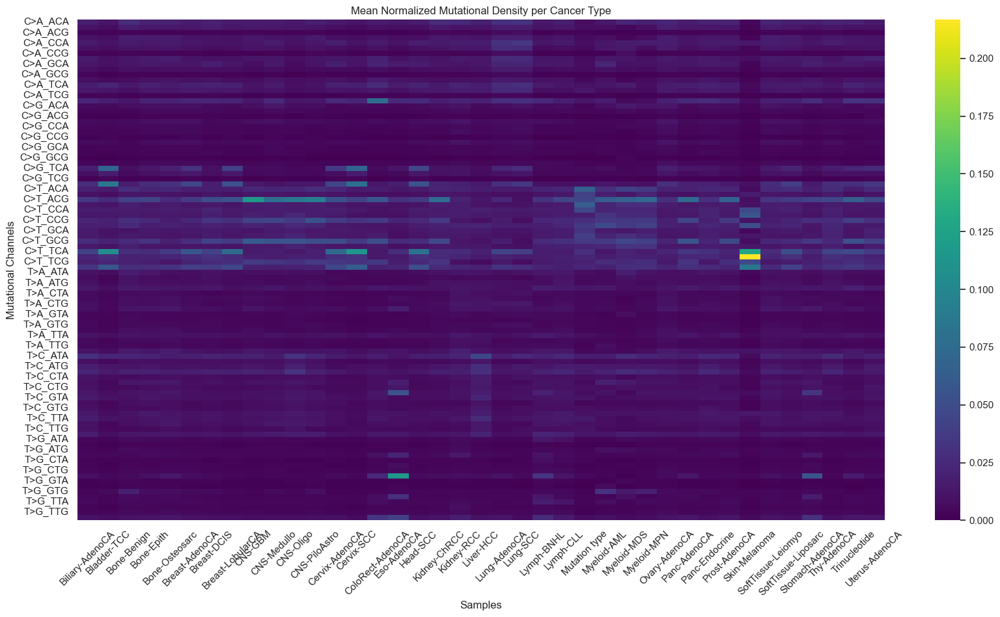

In [494]:
# plotting the mean_normalized_df
plt.figure(figsize=(20, 10))
sns.heatmap(avg_densities_96, cmap='viridis')
plt.title('Mean Normalized Mutational Density per Cancer Type')
plt.xlabel('Samples')
plt.ylabel('Mutational Channels')
plt.xticks(rotation=45)
plt.show()


We can see the the Skin melanoma has a very different profile than the other cancer types. Clear signal in the C>T mutation type in trinucleotide TCC. <br> 
All other profiles are very similar to each other, with the exception of the T>G mutation type in Eso-AdenoCA. <br>

# for the 6 channels version, I am assuming we just group by using the Mutation Type column and then normalize the sum of the columns (each sample) to be 1 

In [492]:
df_6channels = somaticMutations.copy()
df_6channels = df_6channels.drop(columns=['Trinucleotide'])
mutation_type_counts = df_6channels.groupby('Mutation type').sum()
mutation_type_counts


,Biliary-AdenoCA::SP117655,Biliary-AdenoCA::SP117556,Biliary-AdenoCA::SP117627,Biliary-AdenoCA::SP117775,Biliary-AdenoCA::SP117332,Biliary-AdenoCA::SP117712,Biliary-AdenoCA::SP117017,Biliary-AdenoCA::SP117031,Biliary-AdenoCA::SP117759,Biliary-AdenoCA::SP117621,...,Uterus-AdenoCA::SP94540,Uterus-AdenoCA::SP95222,Uterus-AdenoCA::SP89389,Uterus-AdenoCA::SP90503,Uterus-AdenoCA::SP92460,Uterus-AdenoCA::SP92931,Uterus-AdenoCA::SP91265,Uterus-AdenoCA::SP89909,Uterus-AdenoCA::SP90629,Uterus-AdenoCA::SP95550
Mutation type,,,,,,,,,,,,,,,,,,,,,
C>A,2406,987,967,2059,502,2558,668,1871,2724,1801,...,1577,2466,920,1074,4531,979,3342,2529,3755,1614
C>G,1731,337,363,1748,587,741,306,984,1008,1708,...,559,3326,1283,1533,623,419,2243,515,14160,1733
C>T,5419,1998,3029,5226,1400,2372,3714,4023,5992,5849,...,2109,4681,2581,2618,12547,1853,3962,8935,10867,2888
T>A,2276,639,545,1098,356,1511,538,1123,1265,1141,...,698,1409,542,529,2955,512,1981,907,1857,981
T>C,1886,783,761,1580,438,3413,1060,1251,1639,1619,...,1159,2100,803,933,5355,807,2584,4806,2565,1258
T>G,1182,344,258,700,173,712,276,716,682,756,...,451,1117,373,421,953,410,1505,537,1589,595


In [215]:
# first group by the columns by the mutation type column
# then sum the number of mutations for each mutation type
# remove the tri-nucleotide column
df_6channels = somaticMutations.copy()
df_6channels = df_6channels.drop(columns=['Trinucleotide'])
mutation_type_counts = df_6channels.groupby('Mutation type').sum()
mutation_type_counts

# normalize the data by the total number of mutations in each sample (column sums to 1)
normalized_df_6channels = mutation_type_counts.div(mutation_type_counts.sum(axis=0), axis=1)
# then group by using the cancer types
cancer_types = [col.split('::')[0] for col in normalized_df_6channels.columns]

avg_densities_6 = normalized_df_6channels.groupby(cancer_types, axis=1).mean()


,Biliary-AdenoCA,Bladder-TCC,Bone-Benign,Bone-Epith,Bone-Osteosarc,Breast-AdenoCA,Breast-DCIS,Breast-LobularCA,CNS-GBM,CNS-Medullo,...,Ovary-AdenoCA,Panc-AdenoCA,Panc-Endocrine,Prost-AdenoCA,Skin-Melanoma,SoftTissue-Leiomyo,SoftTissue-Liposarc,Stomach-AdenoCA,Thy-AdenoCA,Uterus-AdenoCA
Mutation type,,,,,,,,,,,,,,,,,,,,,
C>A,0.170387,0.131215,0.181995,0.171002,0.180334,0.169907,0.172291,0.158195,0.139854,0.173489,...,0.194878,0.163951,0.193942,0.177001,0.064163,0.178256,0.171163,0.170663,0.156819,0.176515
C>G,0.084541,0.232108,0.065612,0.099642,0.120518,0.155284,0.084166,0.153534,0.070960,0.086419,...,0.146856,0.077703,0.094813,0.077073,0.037272,0.121741,0.133993,0.063630,0.105879,0.119527
C>T,0.338454,0.398582,0.354131,0.339812,0.295814,0.358847,0.376215,0.410365,0.454750,0.414498,...,0.276827,0.423800,0.333373,0.381815,0.726708,0.307873,0.363206,0.305643,0.400866,0.374262
T>A,0.121645,0.065927,0.147511,0.121450,0.135806,0.101972,0.115799,0.086000,0.113140,0.098787,...,0.137200,0.109516,0.114735,0.113104,0.053338,0.131716,0.123764,0.104903,0.113482,0.089106
T>C,0.219762,0.132232,0.155316,0.191572,0.181298,0.146947,0.180661,0.140176,0.171587,0.172215,...,0.167372,0.152794,0.200893,0.173426,0.079275,0.191357,0.150772,0.190846,0.176684,0.177491
T>G,0.065212,0.039937,0.095434,0.076521,0.086230,0.067044,0.070867,0.051730,0.049709,0.054592,...,0.076867,0.072236,0.062245,0.077582,0.039244,0.069058,0.057101,0.164314,0.046270,0.063099


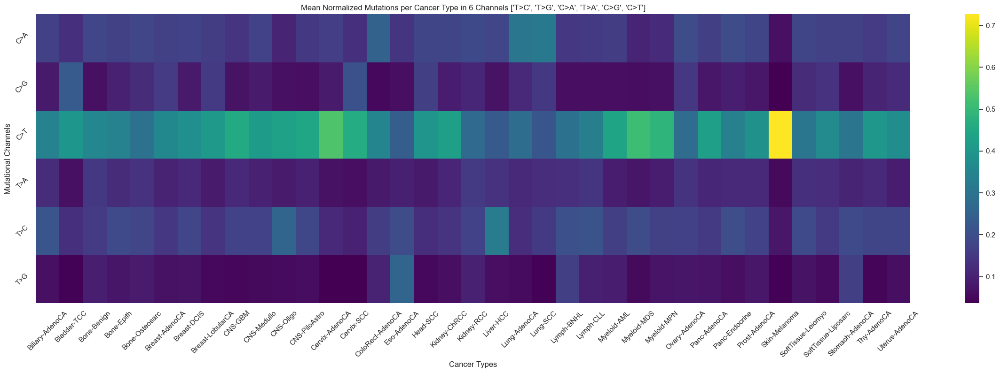

In [521]:
plt.figure(figsize=(30, 8))
sns.heatmap(avg_densities_6, cmap='viridis')
plt.title(f'Mean Normalized Mutations per Cancer Type in 6 Channels {str(channels6)}')
plt.xlabel('Cancer Types')
plt.ylabel('Mutational Channels')
plt.yticks(rotation=45)
plt.xticks(rotation=45)
# make x axis labels more readable by making them bigger
plt.show()

In [539]:
# heeat map using plotly, this will propably not show in csc jupyternotebooks, but it will show in the folder 'images' as a png file
fig = px.imshow(avg_densities_6, color_continuous_scale='viridis')

fig.update_layout(
    title=f'Mean Normalized Mutations per Cancer Type in 6 Channels {str(channels6[1]), channels6[0], channels6[3], channels6[5], channels6[4], channels6[2]}',
    xaxis_title='Cancer Types',
    yaxis_title='Mutational Channels',
    yaxis_nticks=12,
    xaxis_tickangle=-45,
    width=1000,
    height=400
)


fig.show()

# save the image to a file in folder images 
fig.write_image("./images/mean_normalized_mutations_per_cancer_type_in_6_channels.png")


Here we can see that the C>T is common in all cancer types but distinctive high in Skin Melanoma. <br>
Lung cancer has a high C>A mutation type. <br>
Eso-AdenoCA has a high T>G mutation type while in other cancer types this type of mutation is not veri common. <br>

#### Problem 1d: 
Study now the signatures given. How different are they? Make a visualisation of all pairwise distances between the individual signatures. Use at least the following three metrics, cosine distance, Euclidian distance, Kullback-Leibler divergence. Use for visualisation heatmaps, c.f. Seaborn package, remember to add colour bars with a scale to all heat maps you plot. Make also figures where you plot all pairwise distances in an ordered way from most similar to least similar. Comment on how the change in the using distance/divergence measure affects this plot.  

In [628]:
df = SBS_sig.iloc[:,2:].T

In [629]:
import math
from scipy.spatial.distance import euclidean, cosine

rows = df.shape[0]

eulidian_distances = np.zeros((rows, rows))
cosine_distances = np.zeros((rows, rows))
KL_distances = np.zeros((rows, rows))

def calculate_KL_divergence(a, b):
    """Function to calculate the KL divergence between two vectors
    
    Arguments:
    a -- the first vector
    b -- the second vector
    
    Returns:
    the KL divergence between the two vectors"""
    P = np.asarray(a, dtype=np.float64)
    Q = np.asarray(b, dtype=np.float64)
    
    # Add a small value to Q to avoid division by zero or log of zero
    Q = np.maximum(Q, 1e-10)
    p = np.maximum(P, 1e-10)
    return np.sum(P * np.log(P / Q))


for i in range(rows):
    for j in range(rows):
        a = df.iloc[i,:].values # row vector 1
        b = df.iloc[j,:].values # row vector 2
        eulidian_distances[i,j] = euclidean(a, b) 
        cosine_distances[i,j] = cosine(a, b)
        KL_distances[i,j] = calculate_KL_divergence(a, b)

cosine_distances = pd.DataFrame(cosine_distances, index=df.index, columns=df.index)
euclidean_distances = pd.DataFrame(eulidian_distances, index=df.index, columns=df.index)
KL_distances = pd.DataFrame(KL_distances, index=df.index, columns=df.index)

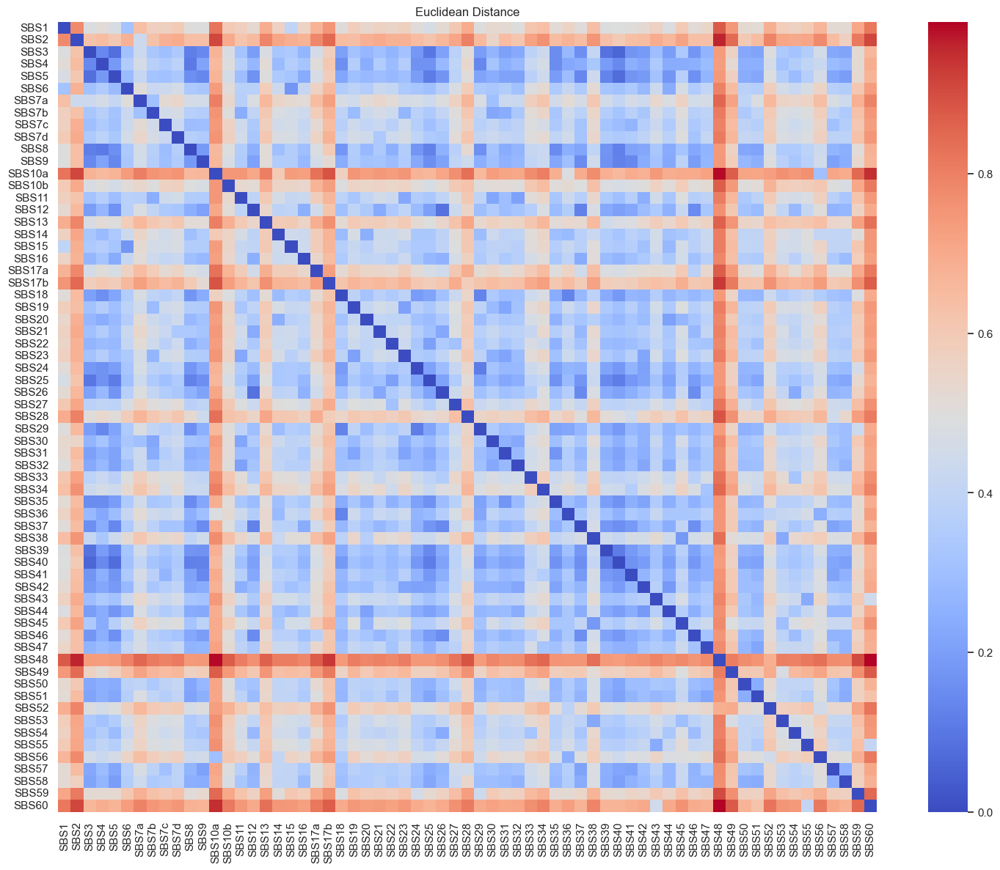

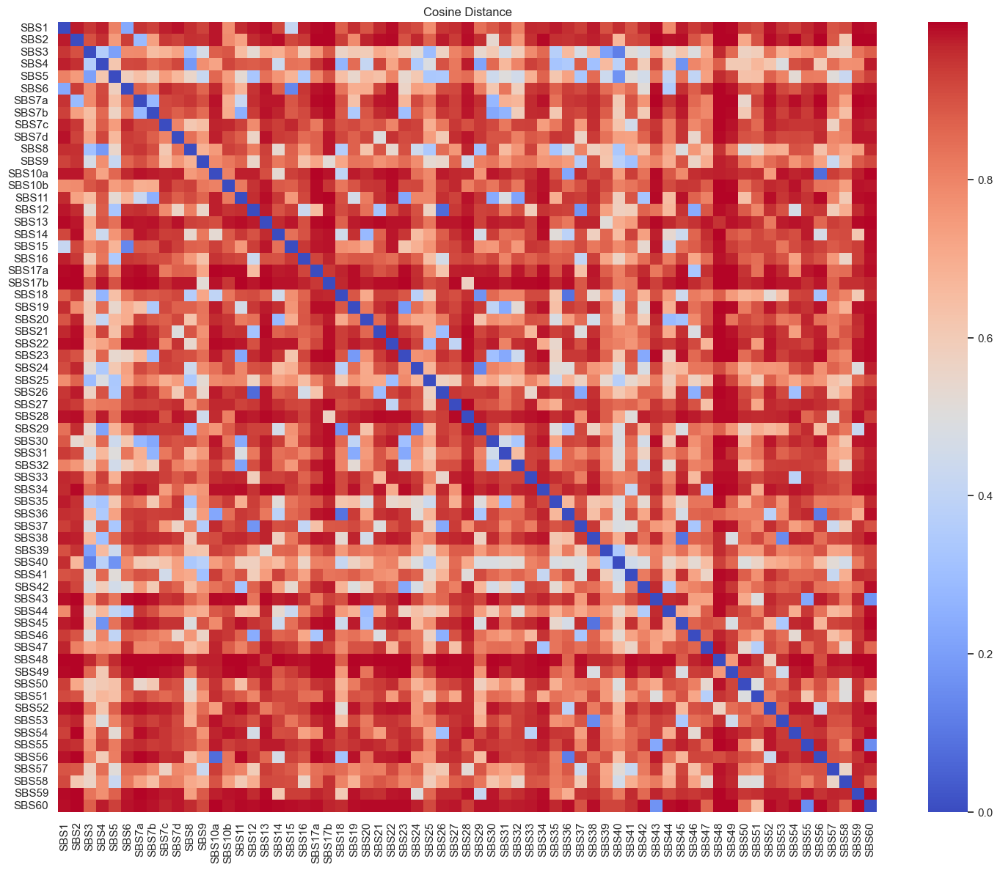

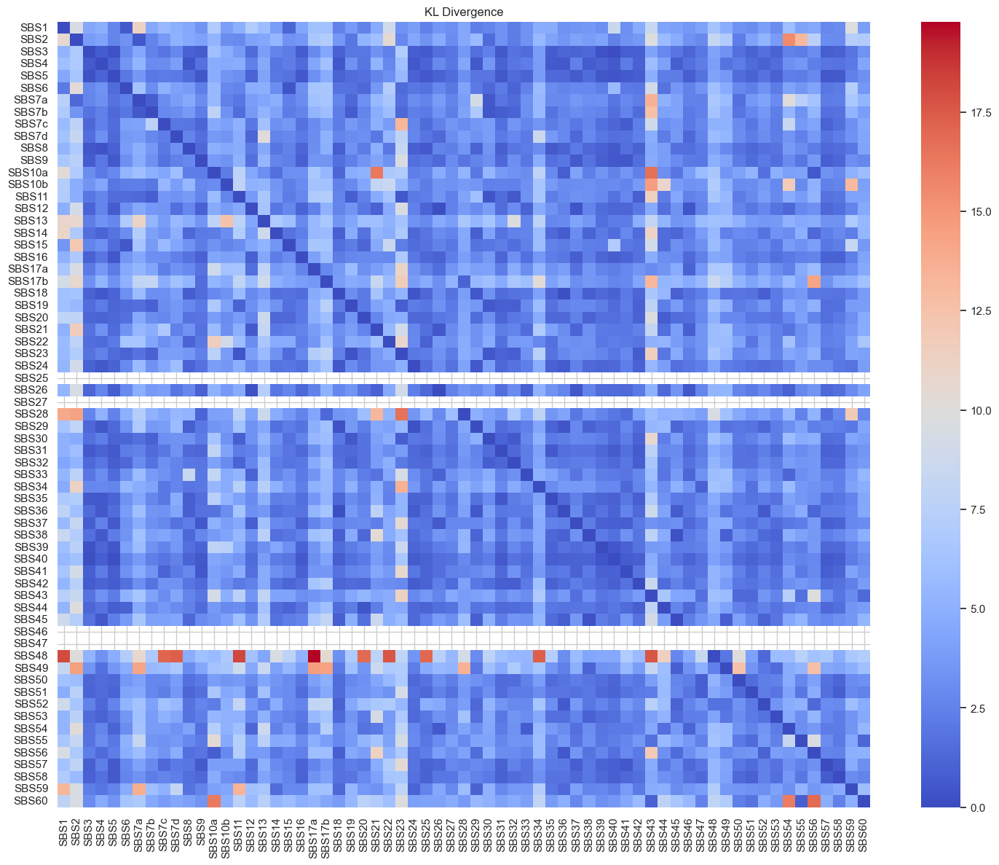

In [630]:
# plot all three distance heatmaps
plt.figure(figsize=(18, 14)) # 14 is 
sns.heatmap(euclidean_distances, cmap='coolwarm')
plt.title('Euclidean Distance')
plt.show()
plt.figure(figsize=(18, 14))
sns.heatmap(cosine_distances, cmap='coolwarm')
plt.title('Cosine Distance')
plt.show()
plt.figure(figsize=(18, 14))
sns.heatmap(KL_distances, cmap='coolwarm')
plt.title('KL Divergence')

plt.show()



### **Using the euclidean distance** 
Euclidean distance is the square root of the sum of the squared differences between the two vectors. Very straigh forward distance between two vectors.
$$ d(P, Q) = \sqrt{\sum_{i=1}^{n} (p_i - q_i)^2} $$

where in here P and Q are the two vectors we want to compare,  the two signatures values (rows in the data frame) as vectors. <br>

We can see that the signatures are not very similar to each other --> alot of blue in the plot <br>
There signatures SBS1, SBS2, SBS10a, SBS17a, SBS17b, SBS48, SBS49 and SBS60 look very similar to all other signatures. <br>


### **Using the cosine distance**
[The cosine distance is the cosine of the angle between two vectors.](https://en.wikipedia.org/wiki/Cosine_similarity)
$$ \text{cosine similarity}(A, B) = \frac{A \cdot B}{\|A\| \|B\|} = \frac{\sum_{i=1}^{n} a_i b_i}{\sqrt{\sum_{i=1}^{n} a_i^2} \sqrt{\sum_{i=1}^{n} b_i^2}} $$
When using cosine distance the signatures are more similar to each other in comparison to the euclidian distances  --> alot of red in the plot. <br> This is probably because the cosine distance is not affected by the magnitude of the vectors unlike the euclidean distance. <br> It only measures the angle between the two vectors. <br>
SBS40 seems to be the most different from all other signatures and SBS 48 and 49 the most similar, meaning the angle to other SBS vectors is the largest <br>


### **Using the Kullback-Leibler divergence**
The Kullback-Leibler divergence is a measure of how one probability distribution diverges from a second, expected probability distribution. <br> 
["Distance between two data distributions P and Q "](https://towardsdatascience.com/understanding-kl-divergence-f3ddc8dff254)
$$ D_{KL}(P \parallel Q) = \sum_{i} P(i) \log\left(\frac{P(i)}{Q(i)}\right) $$

In here since the sum up to 1 in each signature, we can use them as probability distributions. <br>
In the plot the dark blue means the distributions are identical and the red means the distributions are very different. <br>

When using the Kullback-Leibler divergence the signatures are not very similar to each other. <br>
This is probably because the Kullback-Leibler divergence is a measure of how one probability distribution diverges from a second, expected probability distribution. With the signatures the distributions are not very similar to each other. <br> This can be due to the method used to calculate the signatures or the biological differences. <br>
Also since the KL is not symmetric $D_{KL}(P \parallel Q) \neq D_{KL}(Q \parallel P)$ the plot is not symmetric. <br>

All in all the Euclidian distance and the Kullback-Leibler divergence are the most similar to each other. Even though they are very different from each other. <br> The cosine distance is the most different from the other two. <br> If you look at individual pairs like SBS48 and SBS17a in all distance plots these are very different from each other. <br>

# Make also figures where you plot all pairwise distances in an ordered way from most similar to least similar

In [480]:
# order the most similar signatures to the least similar
# the most similar signature is the one with the smallest distance
cosine_distances_ordered = cosine_distances.copy()
cosine_distances_ordered = cosine_distances_ordered.stack().reset_index()
cosine_distances_ordered.columns = ['Signature 1', 'Signature 2', 'Cosine Distance']
# order from the most similar to the least similar
cosine_distances_ordered = cosine_distances_ordered.sort_values(by='Cosine Distance', ascending=False)

cosine_distances_ordered['Signature Pairs'] = cosine_distances_ordered['Signature 1'] + ',' + cosine_distances_ordered['Signature 2']

# remove cosine distance 0
cosine_distances_ordered = cosine_distances_ordered[cosine_distances_ordered['Cosine Distance'] != 0]

# remove duplicate pairs where Signature 1 and Signature 2 are swapped
cosine_distances_ordered['Signature Pairs'] = cosine_distances_ordered['Signature Pairs'].apply(lambda x: ','.join(sorted(x.split(','))))
cosine_distances_ordered = cosine_distances_ordered.drop_duplicates(subset='Signature Pairs')



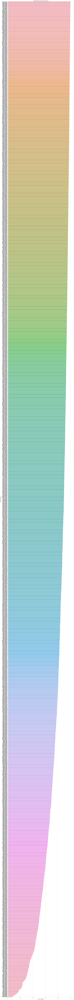

In [481]:

# Creating a horizontal bar plot
plt.figure(figsize=(15, 200))  
sns.barplot(x='Cosine Distance', y='Signature Pairs', data=cosine_distances_ordered,
            order=cosine_distances_ordered.sort_values('Cosine Distance', ascending=False)['Signature Pairs'])

plt.title('Cosine Distance between Signature Pairs')
plt.xlabel('Cosine Distance')
plt.ylabel('Signature Pairs')
plt.tight_layout() 
plt.show()


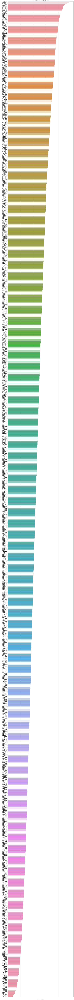

In [482]:
# same for the euclidean distance
euclidean_distances_ordered = euclidean_distances.copy()
euclidean_distances_ordered = euclidean_distances_ordered.stack().reset_index()
euclidean_distances_ordered.columns = ['Signature 1', 'Signature 2', 'Euclidean Distance']
# order from the most similar to the least similar
euclidean_distances_ordered = euclidean_distances_ordered.sort_values(by='Euclidean Distance', ascending=False)

euclidean_distances_ordered['Signature Pairs'] = euclidean_distances_ordered['Signature 1'] + ',' + euclidean_distances_ordered['Signature 2']

# remove euclidean distance 0
euclidean_distances_ordered = euclidean_distances_ordered[euclidean_distances_ordered['Euclidean Distance'] != 0]

# remove duplicate pairs where Signature 1 and Signature 2 are swapped
euclidean_distances_ordered['Signature Pairs'] = euclidean_distances_ordered['Signature Pairs'].apply(lambda x: ','.join(sorted(x.split(','))))
euclidean_distances_ordered = euclidean_distances_ordered.drop_duplicates(subset='Signature Pairs')



# Creating a horizontal bar plot


plt.figure(figsize=(15, 200))
sns.barplot(x='Euclidean Distance', y='Signature Pairs', data=euclidean_distances_ordered,
            order=euclidean_distances_ordered.sort_values('Euclidean Distance', ascending=False)['Signature Pairs'])

plt.title('Euclidean Distance between Signature Pairs')
plt.xlabel('Euclidean Distance')
plt.ylabel('Signature Pairs')
plt.tight_layout()
plt.show()




In [484]:
# same for the KL divergence
KL_distances_ordered = KL_distances.copy()
KL_distances_ordered = KL_distances_ordered.stack().reset_index()
KL_distances_ordered.columns = ['Signature 1', 'Signature 2', 'KL Divergence']
# order from the most similar to the least similar
KL_distances_ordered = KL_distances_ordered.sort_values(by='KL Divergence', ascending=False)

KL_distances_ordered['Signature Pairs'] = KL_distances_ordered['Signature 1'] + ',' + KL_distances_ordered['Signature 2']

# remove KL divergence 0
KL_distances_ordered = KL_distances_ordered[KL_distances_ordered['KL Divergence'] != 0]

# remove duplicate pairs where Signature 1 and Signature 2 are swapped
KL_distances_ordered['Signature Pairs'] = KL_distances_ordered['Signature Pairs'].apply(lambda x: ','.join(sorted(x.split(','))))
KL_distances_ordered = KL_distances_ordered.drop_duplicates(subset='Signature Pairs')

plt.figure(figsize=(150, 200))

sns.barplot(x='KL Divergence', y='Signature Pairs', data=KL_distances_ordered,
            order=KL_distances_ordered.sort_values('KL Divergence', ascending=False)['Signature Pairs'])

plt.xscale('log')
plt.title('KL Divergence between Signature Pairs')
plt.xlabel('KL Divergence')
plt.ylabel('Signature Pairs')
plt.tight_layout()
plt.show()


### Problem 2: Generate simulated data <a id='Problem1'></a>

#### Problem 2a: 
Use the real somatic counts as an input to make a function that allows you to simulate data, given an input mutation count profile. <br>
Use three different noise models: **Poisson, Negative Binomial and Gaussian.** Make a data set for each noise model and use them in your <br> analysis below. For now you can use the real counts of a sample as its "model" (we return to this in the second assignment).<br>
You just need to generate a simulated sample for each real sample using the three different noise models, in effect you re-sample <br> the counts. Please note that for both Negative Binomial and Gaussian you also need to define variance (or overdispersion), please try a few different values and see how that affects the figures 2b.   

I am quite unsure what is meant by the defined variance ? Do I calculate it from the data or just use a random value ?

In [639]:
import numpy as np
import pandas as pd
from scipy.stats import poisson, nbinom, norm


In [653]:
import numpy as np
from scipy.stats import poisson, nbinom, norm

def simulate_sample(sample_counts, model='poisson', variance=1.0, overdispersion=1.0):
    if model == 'poisson':
        simulated_counts = poisson.rvs(mu=sample_counts)
    elif model == 'negative_binomial':
        # Ensure overdispersion is positive to avoid domain errors
        overdispersion = max(overdispersion, 1e-3)
        
        mean = sample_counts 
        r = 1 / overdispersion # Number of failures until the experiment is stopped
        p = r / (r + mean)  # Probability of success in each trial
        
        simulated_counts = nbinom.rvs(n=r, p=p)
    elif model == 'gaussian':
        # Ensure positive variance
        variance = max(variance, 1e-3)
        simulated_counts = norm.rvs(loc=sample_counts, scale=np.sqrt(variance))
        simulated_counts = np.round(simulated_counts).clip(min=0)  # Ensure counts are non-negative integers
    else:
        raise ValueError(f"Unsupported model: {model}")
    
    return simulated_counts


In [654]:
# copy the mutational data to df
df = somaticMutations.copy()
# Define models and parameters
models = ['poisson', 'negative_binomial', 'gaussian']
variances = [1.0, 2.0] 
overdispersions = [1.0, 1.5]  
# Simulate data
simulated_data = {}
for model in models:
    if model == 'gaussian':
        for variance in variances:
            key = f'{model}_var{variance}'
            simulated_data[key] = df.apply(simulate_sample, axis=0, model=model, variance=variance)
    elif model == 'negative_binomial':
        for overdispersion in overdispersions:
            key = f'{model}_overdispersion{overdispersion}'
            simulated_data[key] = df.apply(simulate_sample, axis=0, model=model, overdispersion=overdispersion)
    else:
        simulated_data[model] = df.apply(simulate_sample, axis=0, model=model)

# `simulated_data` is a dictionary with keys for each model/parameter combination and values as the simulated DataFrames.


In [656]:
simulated_data.keys()

dict_keys(['poisson', 'negative_binomial_overdispersion1.0', 'negative_binomial_overdispersion1.5', 'gaussian_var1.0', 'gaussian_var2.0'])

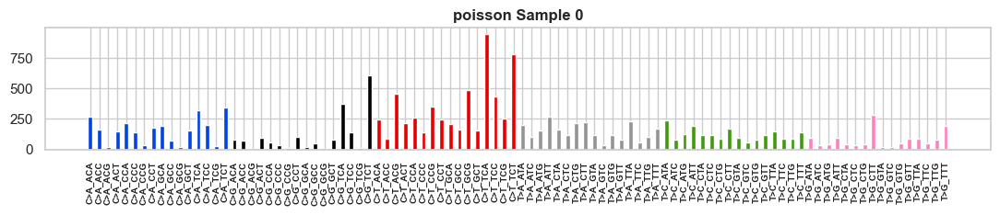

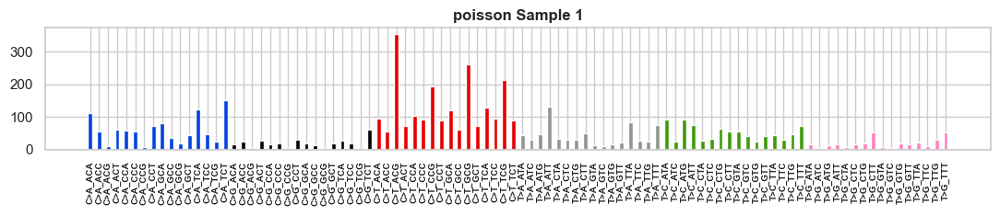

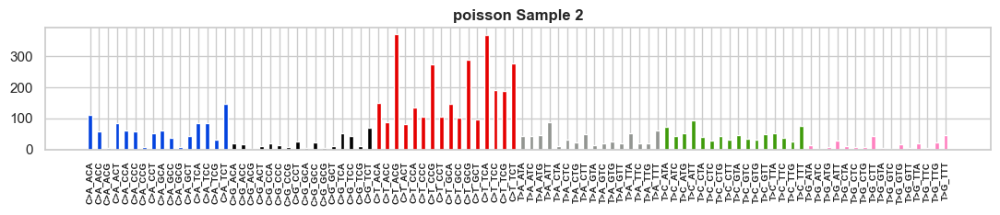

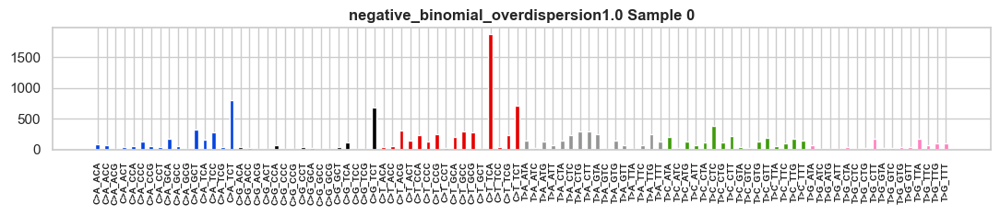

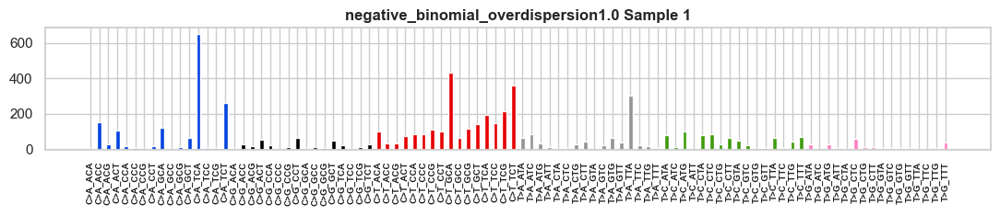

...

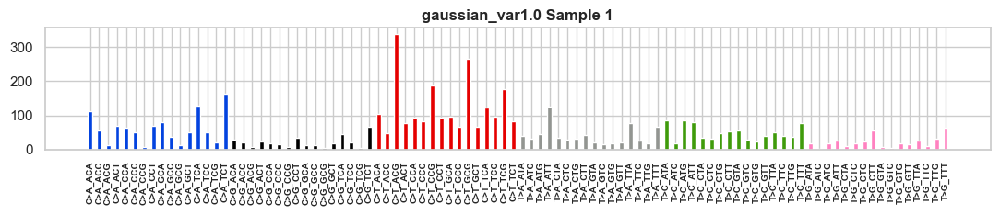

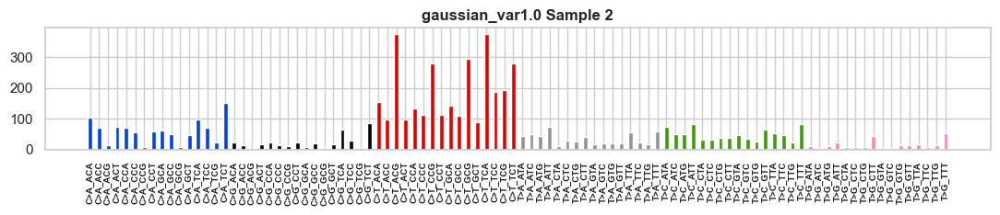

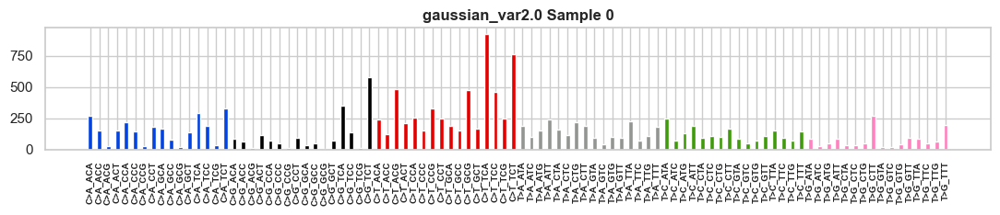

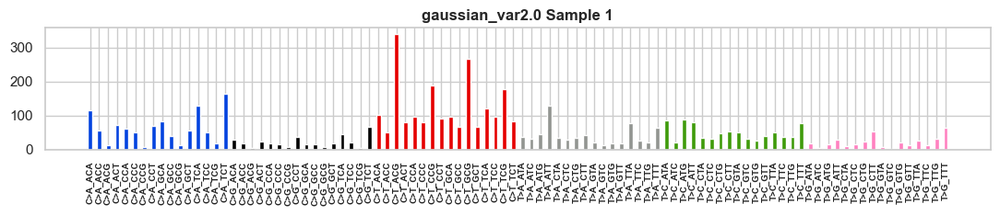

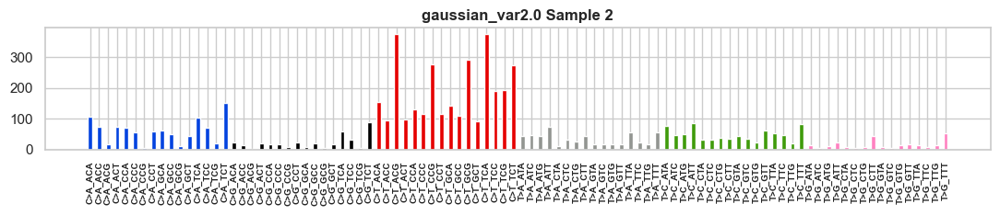

In [657]:
# plot the first 10 samples of the simulated data for all models
# using the function plot_mutationchannels
for model, data in simulated_data.items():
    for i in range(3):
        plot_mutationchannels(data.iloc[:,i], f'{model} Sample {i}')

#### Problem 2b:
Make a scatter plot of the input counts vs. simulated counts from the model (see for example in lecture slides L1) for each one of the noise models. Use log scale, comment on what you see? Is the noise additive or multiplicative?

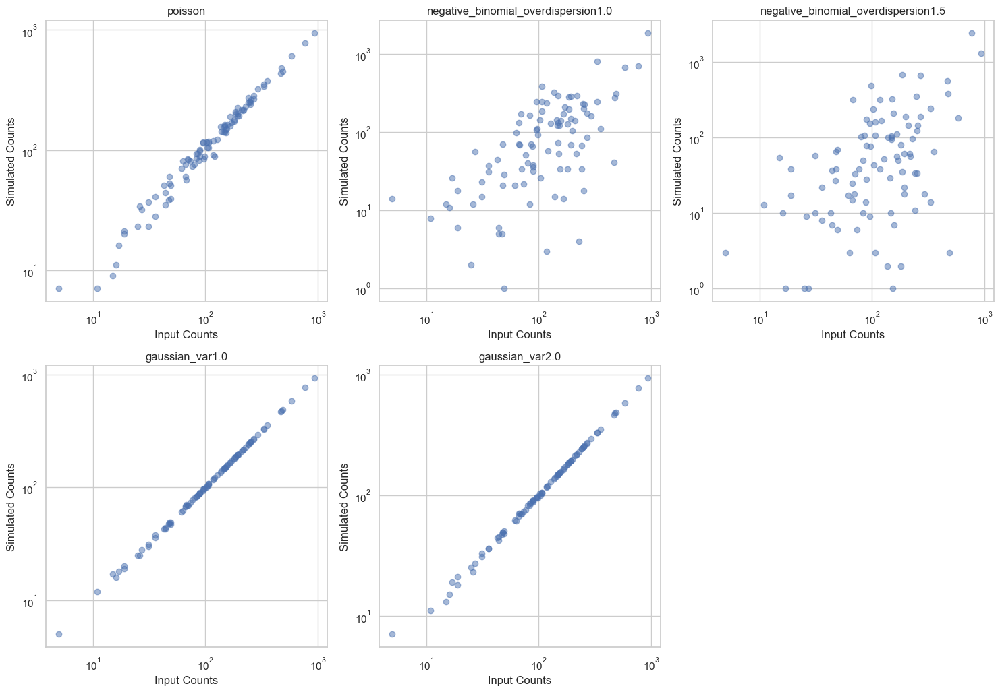

In [658]:
# Make a scatter plot of the input counts vs. simulated counts from the model (see for example in lecture slides L1) for each one of the noise models. 
# Use log scale, comment on what you see? Is the noise additive or multiplicative?

input_counts = somaticMutations['Biliary-AdenoCA::SP117655']

simulated_data_SP117655 = {model: data['Biliary-AdenoCA::SP117655'] for model, data in simulated_data.items()}

# Make a scatter plot of the input counts vs. simulated counts from the model
plt.figure(figsize=(15, 15))
for i, (model, data) in enumerate(simulated_data_SP117655.items()):
    plt.subplot(3, 3, i + 1)
    plt.scatter(input_counts, data, alpha=0.5)
    plt.xscale('log')
    plt.yscale('log')
    plt.title(model)
    plt.xlabel('Input Counts')
    plt.ylabel('Simulated Counts')
plt.tight_layout()
plt.show()


I am not sure how to interpret the scatter plot. I am assuming the x-axis is the real counts and the y-axis is the simulated counts. <br>
Since the line is diagonal in poisson with some noise, maybe its multiplicative. <br>
